In [1]:
import torch
torch.cuda.empty_cache()
# torch.zeros(1).cuda()

In anaconda terminal:

pip install -i https://test.pypi.org/simple/ supervision==0.3.0

pip install pytorch_lightning==2.0

pip install transformers

pip install timm

pip install pycocotools

pip install -q coco_eval

In [2]:
import roboflow
import supervision
import transformers
import pytorch_lightning

In [3]:
api_key="5HHY7n4KGmB11S6LTqa1"

In [4]:
from transformers import DetrForObjectDetection, DetrImageProcessor


# settings
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
CHECKPOINT = 'facebook/detr-resnet-50'
CONFIDENCE_TRESHOLD = 0.5
IOU_TRESHOLD = 0.8

image_processor = DetrImageProcessor.from_pretrained(CHECKPOINT, token=api_key)
model = DetrForObjectDetection.from_pretrained(CHECKPOINT, token=api_key)
model.to(DEVICE)

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


DetrForObjectDetection(
  (model): DetrModel(
    (backbone): DetrConvModel(
      (conv_encoder): DetrConvEncoder(
        (model): FeatureListNet(
          (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
          (bn1): DetrFrozenBatchNorm2d()
          (act1): ReLU(inplace=True)
          (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
          (layer1): Sequential(
            (0): Bottleneck(
              (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (bn1): DetrFrozenBatchNorm2d()
              (act1): ReLU(inplace=True)
              (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
              (bn2): DetrFrozenBatchNorm2d()
              (drop_block): Identity()
              (act2): ReLU(inplace=True)
              (aa): Identity()
              (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      

In [36]:
# Augmented dataset
from roboflow import Roboflow
rf = Roboflow(api_key="5HHY7n4KGmB11S6LTqa1")
project = rf.workspace("eclipseai").project("detr-xray")
version = project.version(1)
dataset = version.download("coco")

loading Roboflow workspace...
loading Roboflow project...


In [5]:
# Original dataset
from roboflow import Roboflow
rf = Roboflow(api_key="5HHY7n4KGmB11S6LTqa1")
project = rf.workspace("eclipseai").project("detr-xray")
version = project.version(2)
dataset = version.download("coco")

loading Roboflow workspace...
loading Roboflow project...


In [6]:
dataset.location

'C:\\Users\\mdiehl\\detr\\detr-xray-2'

In [7]:
import os
import torchvision


# settings
ANNOTATION_FILE_NAME = "_annotations.coco.json"
TRAIN_DIRECTORY = os.path.join(dataset.location, "train")
VAL_DIRECTORY = os.path.join(dataset.location, "valid")
TEST_DIRECTORY = os.path.join(dataset.location, "test")


class CocoDetection(torchvision.datasets.CocoDetection):
    def __init__(
        self,
        image_directory_path: str,
        image_processor,
        train: bool = True
    ):
        annotation_file_path = os.path.join(image_directory_path, ANNOTATION_FILE_NAME)
        super(CocoDetection, self).__init__(image_directory_path, annotation_file_path)
        self.image_processor = image_processor

    def __getitem__(self, idx):
        images, annotations = super(CocoDetection, self).__getitem__(idx)
        image_id = self.ids[idx]
        annotations = {'image_id': image_id, 'annotations': annotations}
        encoding = self.image_processor(images=images, annotations=annotations, return_tensors="pt")
        pixel_values = encoding["pixel_values"].squeeze()
        labels = encoding["labels"][0]

        return pixel_values, labels


TRAIN_DATASET = CocoDetection(
    image_directory_path=TRAIN_DIRECTORY,
    image_processor=image_processor,
    train=True)
VAL_DATASET = CocoDetection(
    image_directory_path=VAL_DIRECTORY,
    image_processor=image_processor,
    train=False)
TEST_DATASET = CocoDetection(
    image_directory_path=TEST_DIRECTORY,
    image_processor=image_processor,
    train=False)

print("Number of training examples:", len(TRAIN_DATASET))
print("Number of validation examples:", len(VAL_DATASET))
print("Number of test examples:", len(TEST_DATASET))

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Number of training examples: 2025
Number of validation examples: 577
Number of test examples: 290


In [8]:
import random
import cv2
import numpy as np
import os
import supervision as sv


# select random image
image_ids = TRAIN_DATASET.coco.getImgIds()
image_id = random.choice(image_ids)
print('Image #{}'.format(image_id))

# load image and annotatons
image = TRAIN_DATASET.coco.loadImgs(image_id)[0]
annotations = TRAIN_DATASET.coco.imgToAnns[image_id]
image_path = os.path.join(TRAIN_DATASET.root, image['file_name'])
image = cv2.imread(image_path)

# annotate
detections = sv.Detections.from_coco_annotations(coco_annotation=annotations)

# we will use id2label function for training
categories = TRAIN_DATASET.coco.cats
id2label = {k: v['name'] for k,v in categories.items()}

labels = [
    f"{id2label[class_id]}"
    for _, _, class_id, _
    in detections
]

box_annotator = sv.BoxAnnotator()
frame = box_annotator.annotate(scene=image, detections=detections, labels=labels)

# %matplotlib inline
# sv.show_frame_in_notebook(image, (16, 16))

Image #282


In [9]:
from torch.utils.data import DataLoader

def collate_fn(batch):
    # DETR authors employ various image sizes during training, making it not possible
    # to directly batch together images. Hence they pad the images to the biggest
    # resolution in a given batch, and create a corresponding binary pixel_mask
    # which indicates which pixels are real/which are padding
    pixel_values = [item[0] for item in batch]
    encoding = image_processor.pad(pixel_values, return_tensors="pt")
    labels = [item[1] for item in batch]
    return {
        'pixel_values': encoding['pixel_values'],
        'pixel_mask': encoding['pixel_mask'],
        'labels': labels
    }

TRAIN_DATALOADER = DataLoader(dataset=TRAIN_DATASET, collate_fn=collate_fn, batch_size=4, shuffle=True)
VAL_DATALOADER = DataLoader(dataset=VAL_DATASET, collate_fn=collate_fn, batch_size=4)
TEST_DATALOADER = DataLoader(dataset=TEST_DATASET, collate_fn=collate_fn, batch_size=4)

In [162]:
import pytorch_lightning as pl
from transformers import DetrForObjectDetection
import torch


class Detr(pl.LightningModule):

    def __init__(self, lr, lr_backbone, weight_decay):
        super().__init__()
        self.model = DetrForObjectDetection.from_pretrained(
            pretrained_model_name_or_path=CHECKPOINT, 
            num_labels=len(id2label),
            ignore_mismatched_sizes=True
        )
        
        self.lr = lr
        self.lr_backbone = lr_backbone
        self.weight_decay = weight_decay

    def forward(self, pixel_values, pixel_mask):
        return self.model(pixel_values=pixel_values, pixel_mask=pixel_mask)

    def common_step(self, batch, batch_idx):
        pixel_values = batch["pixel_values"]
        pixel_mask = batch["pixel_mask"]
        labels = [{k: v.to(self.device) for k, v in t.items()} for t in batch["labels"]]

        outputs = self.model(pixel_values=pixel_values, pixel_mask=pixel_mask, labels=labels)

        loss = outputs.loss
        loss_dict = outputs.loss_dict

        return loss, loss_dict

    def training_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)     
        # logs metrics for each training_step, and the average across the epoch
        self.log("training_loss", loss)
        for k,v in loss_dict.items():
            self.log("train_" + k, v.item())

        return loss

    def validation_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)     
        self.log("validation/loss", loss)
        for k, v in loss_dict.items():
            self.log("validation_" + k, v.item())
            
        return loss

    def configure_optimizers(self):
        # DETR authors decided to use different learning rate for backbone
        # you can learn more about it here: 
        # - https://github.com/facebookresearch/detr/blob/3af9fa878e73b6894ce3596450a8d9b89d918ca9/main.py#L22-L23
        # - https://github.com/facebookresearch/detr/blob/3af9fa878e73b6894ce3596450a8d9b89d918ca9/main.py#L131-L139
        param_dicts = [
            {
                "params": [p for n, p in self.named_parameters() if "backbone" not in n and p.requires_grad]},
            {
                "params": [p for n, p in self.named_parameters() if "backbone" in n and p.requires_grad],
                "lr": self.lr_backbone,
            },
        ]
        return torch.optim.AdamW(param_dicts, lr=self.lr, weight_decay=self.weight_decay)

    def train_dataloader(self):
        return TRAIN_DATALOADER

    def val_dataloader(self):
        return VAL_DATALOADER

In [163]:
model = Detr(lr=1e-4, lr_backbone=1e-5, weight_decay=1e-4)

batch = next(iter(TRAIN_DATALOADER))
outputs = model(pixel_values=batch['pixel_values'], pixel_mask=batch['pixel_mask'])

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of DetrForObjectDetection were not initialized from the model checkpoin

In [157]:
outputs.logits.shape

torch.Size([4, 100, 5])

In [164]:
from pytorch_lightning import Trainer

dataset.location

# settings
MAX_EPOCHS = 1

# pytorch_lightning < 2.0.0
# trainer = Trainer(gpus=1, max_epochs=MAX_EPOCHS, gradient_clip_val=0.1, accumulate_grad_batches=8, log_every_n_steps=5)

# pytorch_lightning >= 2.0.0
trainer = Trainer(profiler="advanced", devices=1, accelerator="gpu", max_epochs=MAX_EPOCHS, gradient_clip_val=0.1, accumulate_grad_batches=2, log_every_n_steps=5)

trainer.fit(model)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]

  | Name  | Type                   | Params
-------------------------------------------------
0 | model | DetrForObjectDetection | 41.5 M
-------------------------------------------------
41.3 M    Trainable params
222 K     Non-trainable params
41.5 M    Total params
166.010   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 12 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=1` reached.
FIT Profiler Report
Profile stats for: [LightningModule]Detr.configure_callbacks
         7 function calls in 0.000 seconds

   Ordered by: cumulative time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.000    0.000    0.000    0.000 contextlib.py:117(__exit__)
        1    0.000    0.000    0.000    0.000 {built-in method builtins.next}
        1    0.000    0.000    0.000    0.000 profiler.py:54(profile)
        1    0.000    0.000    0.000    0.000 advanced.py:66(stop)
        1    0.000    0.000    0.000    0.000 module.py:890(configure_callbacks)
        1    0.000    0.000    0.000    0.000 {method 'get' of 'dict' objects}
        1    0.000    0.000    0.000    0.000 {method 'disable' of '_lsprof.Profiler' objects}



Profile stats for: [LightningModule]Detr.prepare_data
         7 function calls in 0.000 seconds

   Ordered by: cumulative time

   ncalls  tottime  percall  cumtime  percall f

In [60]:
%cd dataset.location

%load_ext tensorboard
%tensorboard --logdir lightning_logs/

[WinError 2] The system cannot find the file specified: 'dataset.location'
C:\Users\mdiehl\detr


Reusing TensorBoard on port 6006 (pid 2704), started 4 days, 8:37:09 ago. (Use '!kill 2704' to kill it.)

In [96]:
model.to(DEVICE)

Detr(
  (model): DetrForObjectDetection(
    (model): DetrModel(
      (backbone): DetrConvModel(
        (conv_encoder): DetrConvEncoder(
          (model): FeatureListNet(
            (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
            (bn1): DetrFrozenBatchNorm2d()
            (act1): ReLU(inplace=True)
            (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
            (layer1): Sequential(
              (0): Bottleneck(
                (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
                (bn1): DetrFrozenBatchNorm2d()
                (act1): ReLU(inplace=True)
                (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
                (bn2): DetrFrozenBatchNorm2d()
                (drop_block): Identity()
                (act2): ReLU(inplace=True)
                (aa): Identity()
                (conv3): Conv2d(64, 256

Image #128
ground truth


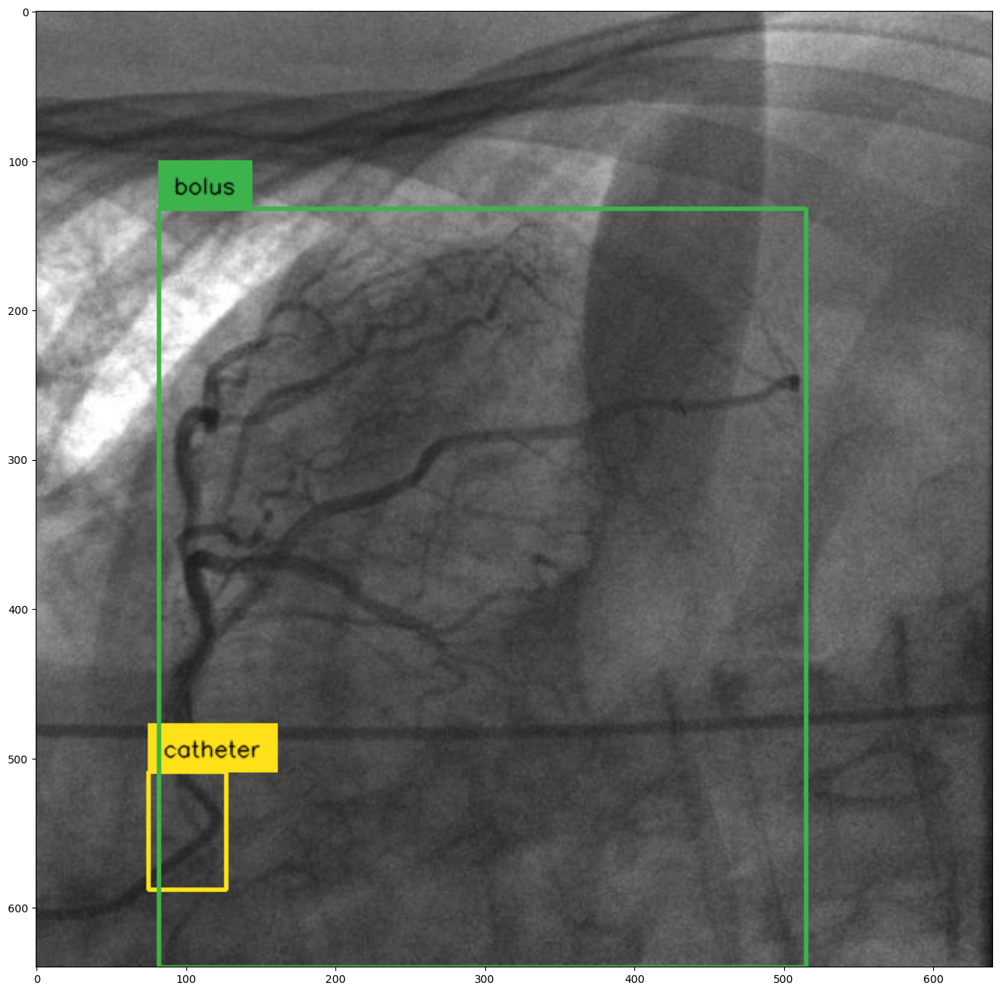

TypeError: Detections.__getitem__ not supported for index of type <class 'numpy.ndarray'>.

In [98]:
import random
import cv2
import numpy as np


# utils
categories = TEST_DATASET.coco.cats
id2label = {k: v['name'] for k,v in categories.items()}
box_annotator = sv.BoxAnnotator()

# select random image
image_ids = TEST_DATASET.coco.getImgIds()
image_id = random.choice(image_ids)
print('Image #{}'.format(image_id))

# load image and annotatons
image = TEST_DATASET.coco.loadImgs(image_id)[0]
annotations = TEST_DATASET.coco.imgToAnns[image_id]
image_path = os.path.join(TEST_DATASET.root, image['file_name'])
image = cv2.imread(image_path)

# annotate
detections = sv.Detections.from_coco_annotations(coco_annotation=annotations)
labels = [f"{id2label[class_id]}" for _, _, class_id, _ in detections]
frame = box_annotator.annotate(scene=image.copy(), detections=detections, labels=labels)

print('ground truth')
%matplotlib inline
sv.show_frame_in_notebook(frame, (16, 16))

# inference
with torch.no_grad():

    # load image and predict
    inputs = image_processor(images=image, return_tensors='pt').to(DEVICE)
    outputs = model(**inputs)

    # post-process
    target_sizes = torch.tensor([image.shape[:2]]).to(DEVICE)
    results = image_processor.post_process_object_detection(
        outputs=outputs,
        threshold=CONFIDENCE_TRESHOLD,
        target_sizes=target_sizes
    )[0]

# annotate
detections = sv.Detections.from_transformers(transformers_results=results).with_nms(threshold=0.5)
labels = [f"{id2label[class_id]} {confidence:.2f}" for _, confidence, class_id, _ in detections]
frame = box_annotator.annotate(scene=image.copy(), detections=detections, labels=labels)

print('detections')
%matplotlib inline
sv.show_frame_in_notebook(frame, (16, 16))

In [99]:
import matplotlib.pyplot as plt
from PIL import Image

# colors for visualization
XMIN_ROI = 1000.0
YMIN_ROI = 1000.0
XMAX_ROI = -1000.0
YMAX_ROI = -1000.0

def convert_to_xywh(boxes, scores, labels):
    xmin, ymin, xmax, ymax = boxes.unbind(1)
    boxes = boxes.cpu()
    draw_roi(xmin, ymin, xmax, ymax, boxes, scores, labels)
    return torch.stack((xmin, ymin, xmax - xmin, ymax - ymin), dim=1)

def draw_roi(xmin, ymin, xmax, ymax, boxes, scores, labels):
    # global XMIN_ROI, YMIN_ROI, XMAX_ROI, YMAX_ROI
    XMIN_ROI = 1000.0
    YMIN_ROI = 1000.0
    XMAX_ROI = -1000.0
    YMAX_ROI = -1000.0
    image_ids = TEST_DATASET.coco.getImgIds()
    image_id = random.choice(image_ids)
    image = TEST_DATASET.coco.loadImgs(image_id)[0]
    image = Image.open(os.path.join(TEST_DATASET.root, image['file_name']))
    # store the lowest xmin and ymin and greatest ymax and xmax to get the ROI containing
    # all of the bounding boxes
    plt.figure(figsize=(16,10))
    plt.imshow(image)
    ax = plt.gca()
    if xmin.numel() == 1:
        xmin = xmin[0].item()
    if ymin.numel() == 1:
        ymin = ymin[0].item()
    if xmax.numel() == 1:
        xmax = xmax[0].item()
    if ymax.numel() == 1:
        ymax = ymax[0].item()
    
    for score, label, (xmin, ymin, xmax, ymax),  in zip(scores, labels, boxes):
        print("score:" +  str(score))
        if (XMIN_ROI > xmin):
            XMIN_ROI = xmin.item()
        if (YMIN_ROI > ymin):
            YMIN_ROI = ymin.item()
        if (XMAX_ROI < xmax):
            XMAX_ROI = xmax.item()
        if (YMAX_ROI < ymax):
            YMAX_ROI = ymax.item()
    print('xmin roi:')
    print(XMIN_ROI)
    print('ymin roi:')
    print(YMIN_ROI)
    print('xmax roi:')
    print(XMAX_ROI)
    print('ymax roi:')
    ax.add_patch(plt.Rectangle((XMIN_ROI, YMIN_ROI), XMAX_ROI - XMIN_ROI, YMAX_ROI - YMIN_ROI,
                            fill=False, color='red', linewidth=3))
    ROI_dir = 'C:\\Users\\mdiehl\\detr\\detr-xray-2\\ROI'
    image_file = 'XA_' + str(image_id) + '.jpg'
    im_dir = os.path.join(ROI_dir, image_file)
    
    # Save the figure before displaying it
    plt.savefig(im_dir)
    plt.axis('off')
    # plt.show()

def prepare_for_coco_detection(predictions):
    coco_results = []
    for original_id, prediction in predictions.items():
        if len(prediction) == 0:
            continue

        boxes = prediction["boxes"]
        scores = prediction["scores"].tolist()
        labels = prediction["labels"].tolist()
        boxes = convert_to_xywh(boxes, scores, labels).tolist()
        coco_results.extend(
            [
                {
                    "image_id": original_id,
                    "category_id": labels[k],
                    "bbox": box,
                    "score": scores[k],
                }
                for k, box in enumerate(boxes)
            ]
        )
    return coco_results

Running evaluation...


  0%|          | 0/145 [00:00<?, ?it/s]

score:0.08998441696166992
score:0.05456717312335968
score:0.11509809643030167
score:0.10241188108921051
score:0.16336126625537872
score:0.27890411019325256
score:0.2606481909751892
score:0.2317291647195816
score:0.03199131041765213
score:0.1169540211558342
score:0.06338846683502197
score:0.11728744953870773
score:0.11274375021457672
score:0.2051623910665512
score:0.13216422498226166
score:0.044344279915094376
score:0.017663773149251938
score:0.03526808321475983
score:0.1772325187921524
score:0.14864793419837952
score:0.05978638678789139
score:0.17043372988700867
score:0.06669779866933823
score:0.09374646842479706
score:0.11877982318401337
score:0.16820700466632843
score:0.04997776448726654
score:0.232696071267128
score:0.05047968029975891
score:0.02953895926475525
score:0.04076423868536949
score:0.12345991283655167
score:0.21458138525485992
score:0.08245435357093811
score:0.043027348816394806
score:0.06007532402873039
score:0.08153501152992249
score:0.22778457403182983
score:0.34074395

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


score:0.04811428114771843
score:0.02551436610519886
score:0.14132514595985413
score:0.05368494987487793
score:0.11121482402086258
score:0.076100654900074
score:0.10608424991369247
score:0.16975069046020508
score:0.03211190551519394
score:0.07837002724409103
score:0.04101819545030594
score:0.13868825137615204
score:0.03175998106598854
score:0.1386283040046692
score:0.11138419061899185
score:0.06953512132167816
score:0.029445715248584747
score:0.03905053436756134
score:0.046650394797325134
score:0.07597443461418152
score:0.07713362574577332
score:0.025941912084817886
score:0.08097062259912491
score:0.08092032372951508
score:0.030239367857575417
score:0.0626068040728569
score:0.032256510108709335
score:0.15605713427066803
score:0.0290769562125206
score:0.022784113883972168
score:0.04376610741019249
score:0.10160544514656067
score:0.15391823649406433
score:0.08175411075353622
score:0.06746464222669601
score:0.033036600798368454
score:0.02931719645857811
score:0.04744669422507286
score:0.17

KeyboardInterrupt: 

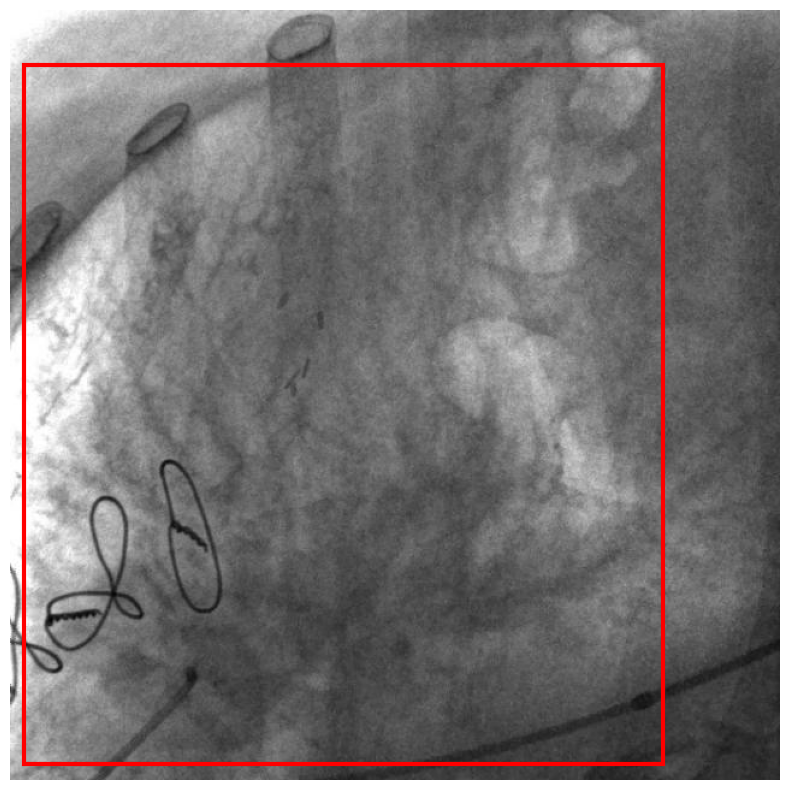

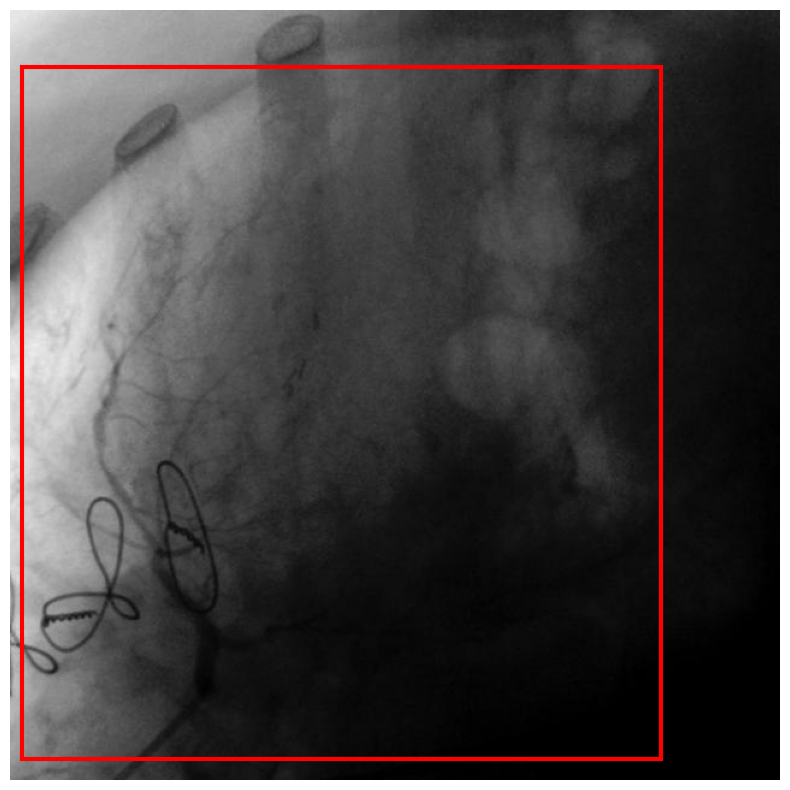

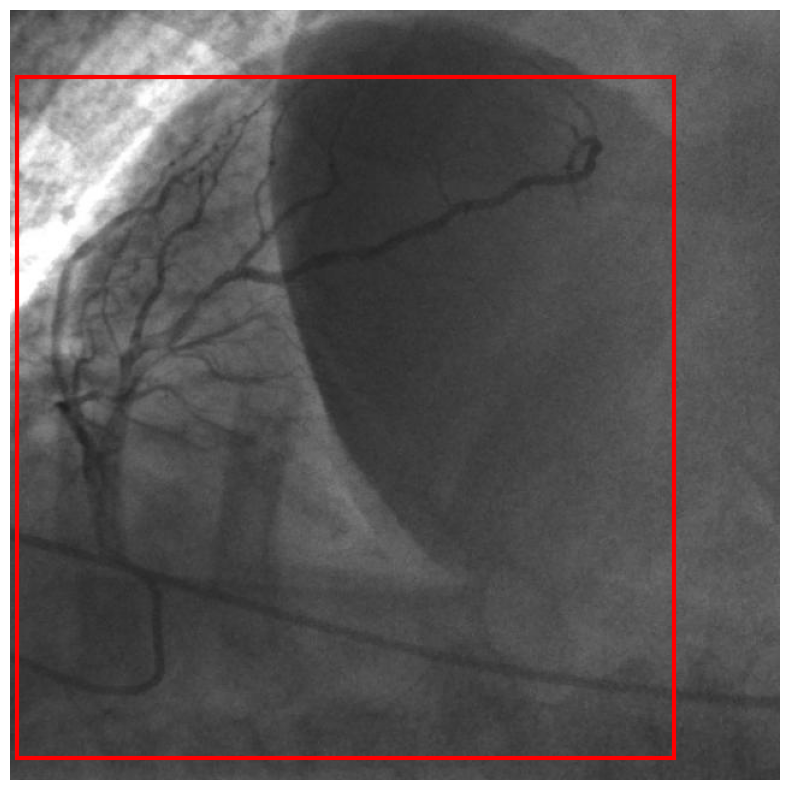

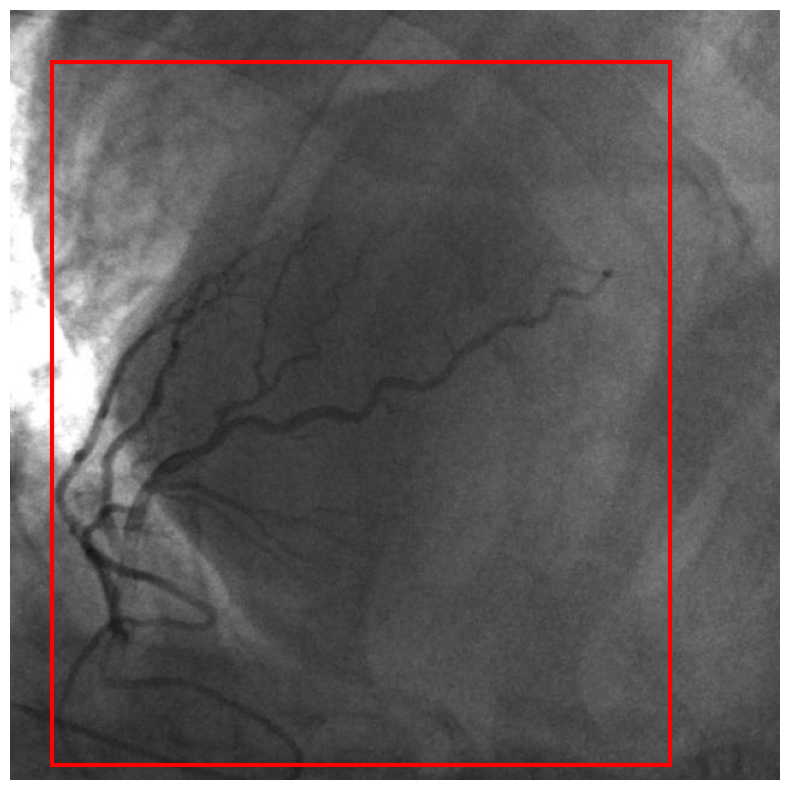

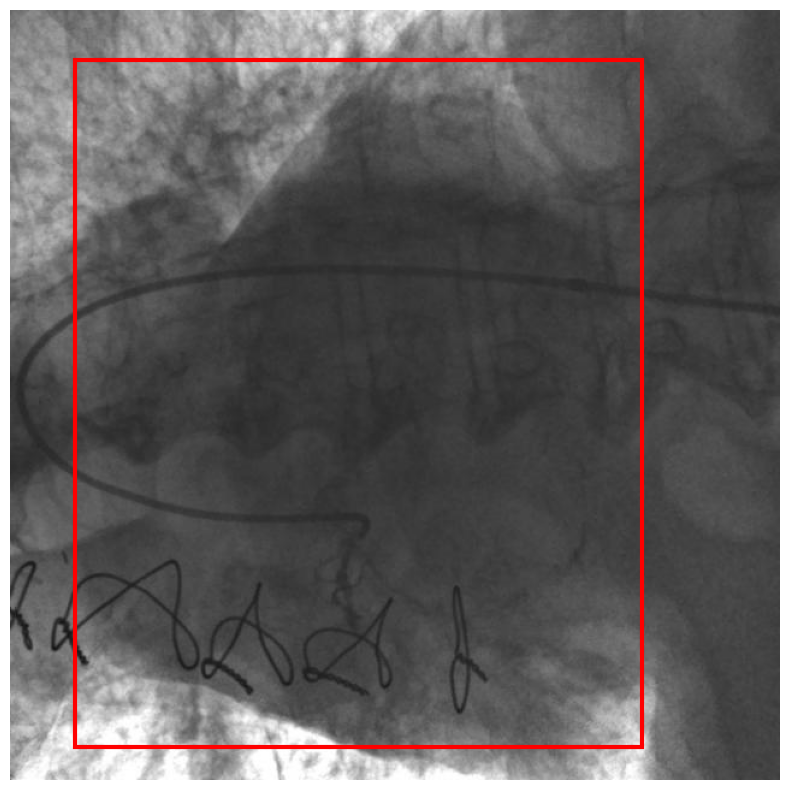

...

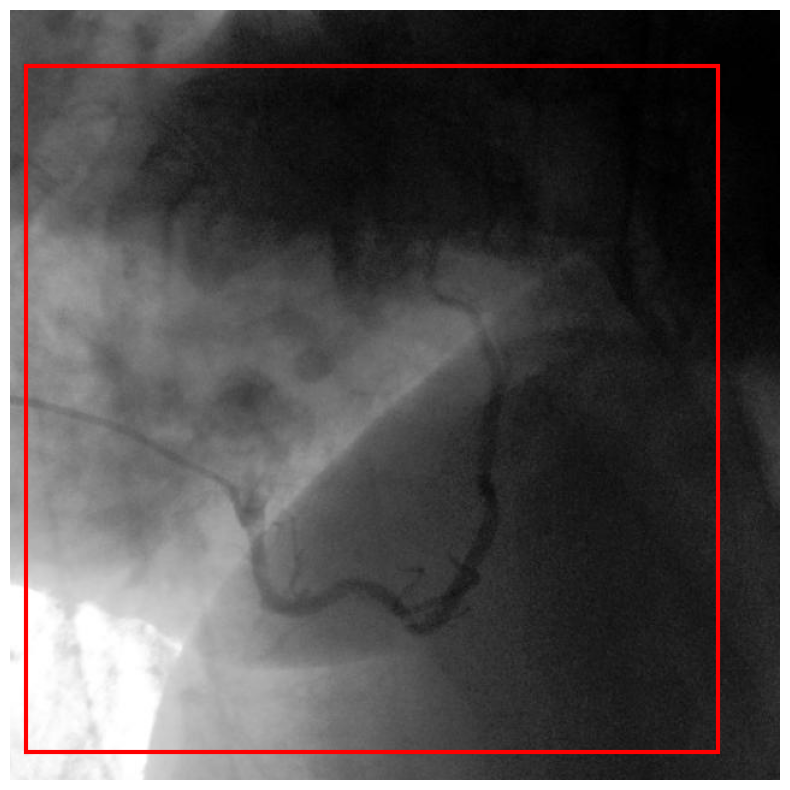

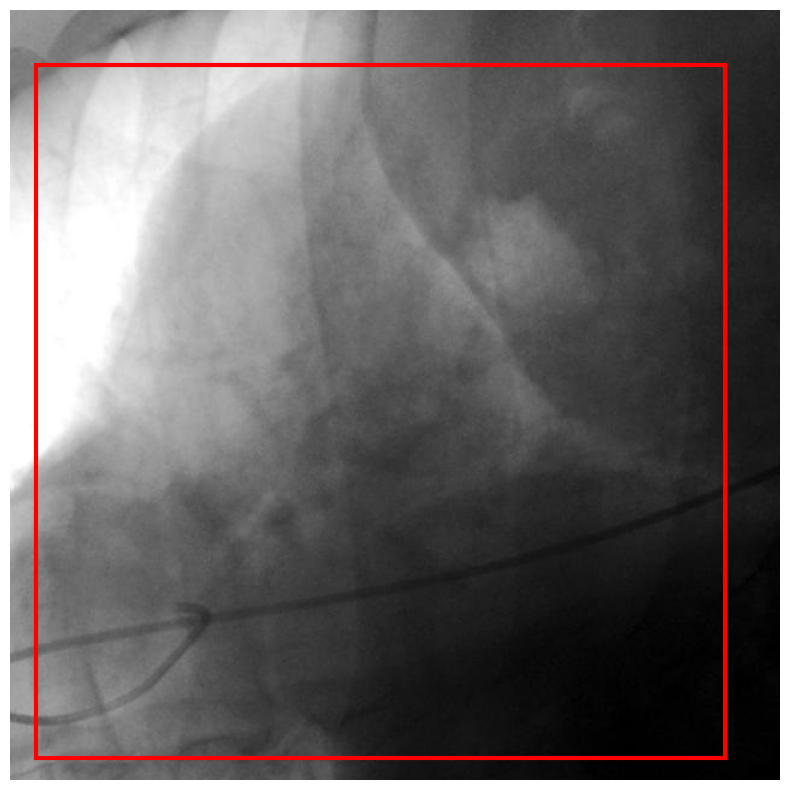

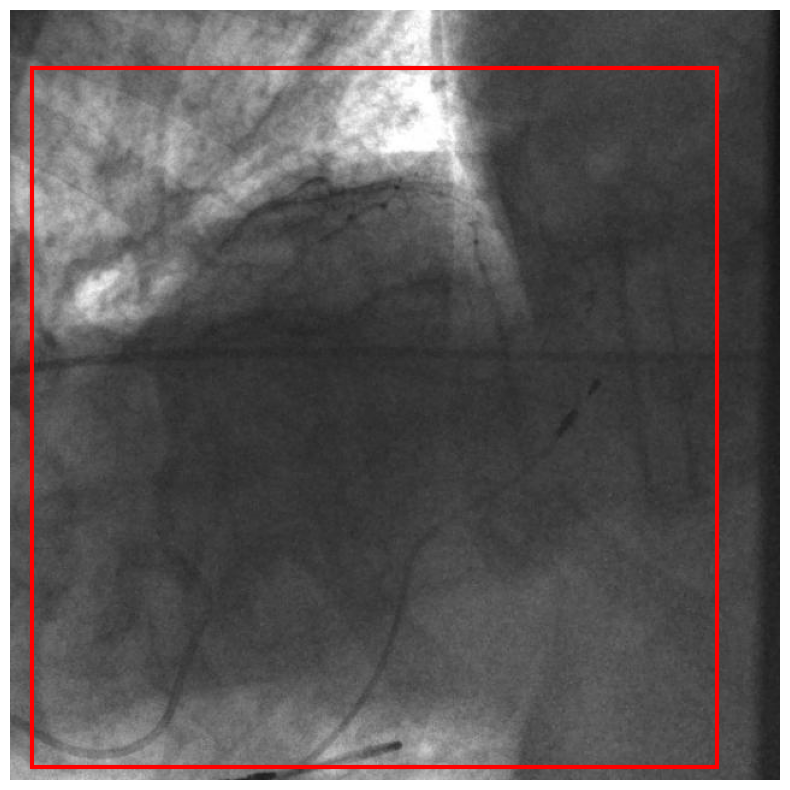

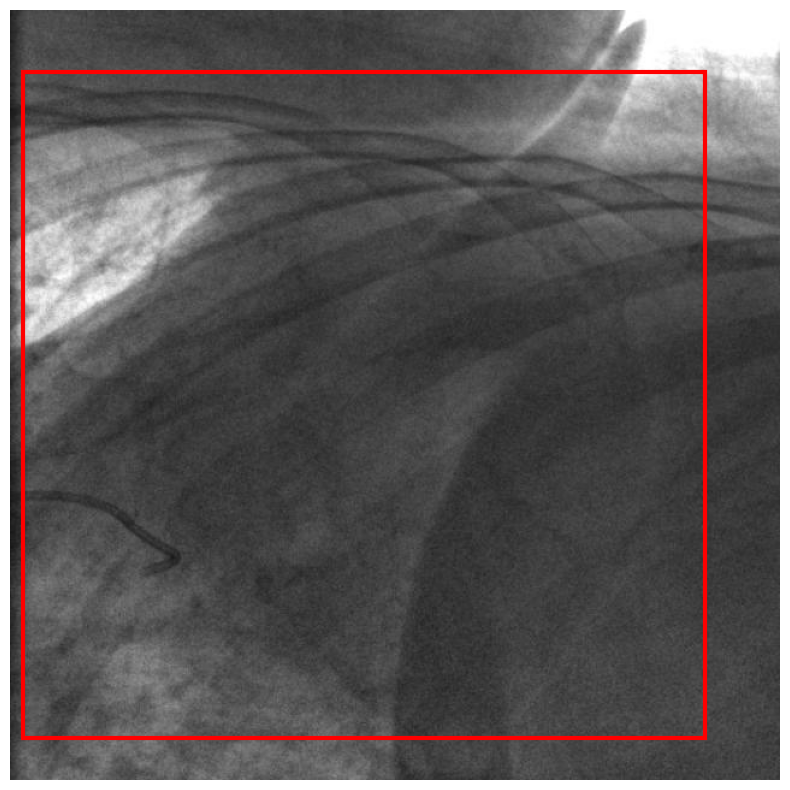

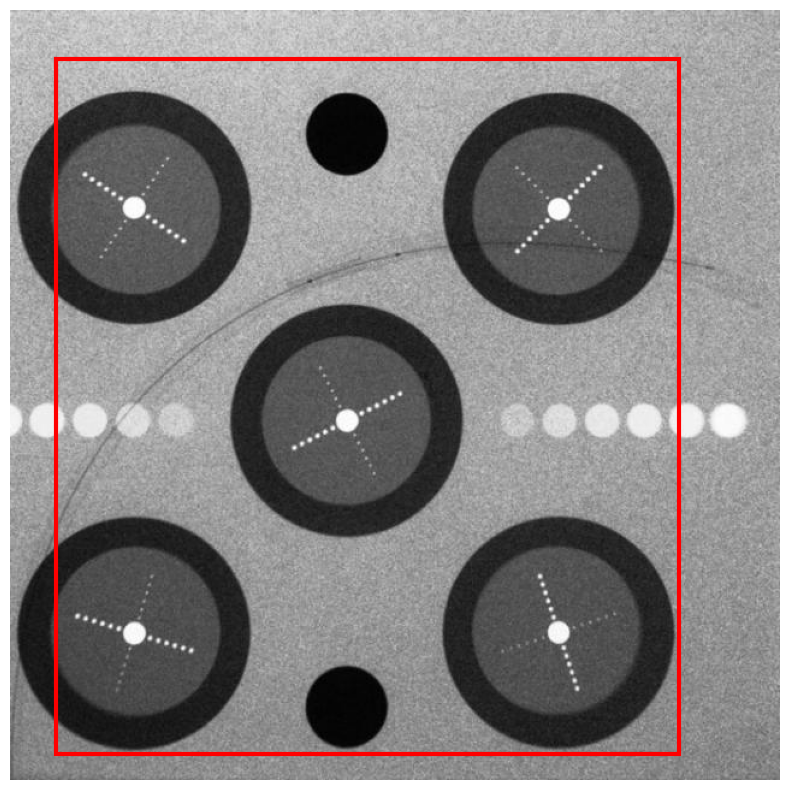

In [100]:
from coco_eval import CocoEvaluator
from tqdm.notebook import tqdm

import numpy as np

# initialize evaluator with ground truth (gt)
evaluator = CocoEvaluator(coco_gt=VAL_DATASET.coco, iou_types=["bbox"])

print("Running evaluation...")
for idx, batch in enumerate(tqdm(VAL_DATALOADER)):
    # get the inputs
    pixel_values = batch["pixel_values"].to(DEVICE)
    pixel_mask = batch["pixel_mask"].to(DEVICE)
    labels = [{k: v.to(DEVICE) for k, v in t.items()} for t in batch["labels"]] # these are in DETR format, resized + normalized

    # forward pass
    with torch.no_grad():
      outputs = model(pixel_values=pixel_values, pixel_mask=pixel_mask)

    # turn into a list of dictionaries (one item for each example in the batch)
    orig_target_sizes = torch.stack([target["orig_size"] for target in labels], dim=0)
    results = image_processor.post_process_object_detection(outputs, target_sizes=orig_target_sizes, threshold=0)

    # provide to metric
    # metric expects a list of dictionaries, each item
    # containing image_id, category_id, bbox and score keys
    predictions = {target['image_id'].item(): output for target, output in zip(labels, results)}
    predictions = prepare_for_coco_detection(predictions)
    evaluator.update(predictions)

evaluator.synchronize_between_processes()
evaluator.accumulate()
evaluator.summarize()

Save the pretrained model below to reuse on further training

In [65]:
import os
HOME = os.getcwd()
print(HOME)

C:\Users\mdiehl\detr


In [66]:
MODEL_PATH = os.path.join(HOME, 'custom-detr-model')

In [67]:
model.model.save_pretrained(MODEL_PATH)

In [68]:
model = DetrForObjectDetection.from_pretrained(MODEL_PATH)
model.to(DEVICE)

DetrForObjectDetection(
  (model): DetrModel(
    (backbone): DetrConvModel(
      (conv_encoder): DetrConvEncoder(
        (model): FeatureListNet(
          (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
          (bn1): DetrFrozenBatchNorm2d()
          (act1): ReLU(inplace=True)
          (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
          (layer1): Sequential(
            (0): Bottleneck(
              (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (bn1): DetrFrozenBatchNorm2d()
              (act1): ReLU(inplace=True)
              (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
              (bn2): DetrFrozenBatchNorm2d()
              (drop_block): Identity()
              (act2): ReLU(inplace=True)
              (aa): Identity()
              (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      